# Understanding Covid-19 with Statistics

## Identifying Communities most at risk of having a higher rate of infections

This first part of the notebook focuses on identifying the communities most at risk of having a high rate of Covid-19 infections. This is done by identifying elements of the demographic data that seem to have a correlation with the percentage of infections or deaths within each county. Understanding the demographic elements that impact the risk of infections within each county will contribute to predicting if a particular county is at high or low risk of infections. 

### Visualizing the  data set

In [81]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from urllib.request import urlopen
import json
import plotly.figure_factory as ff
import plotly.graph_objects as go
import numpy as np
from plotly.subplots import make_subplots
import scipy.stats as scs
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn import metrics
import seaborn as seabornInstance 

In [82]:
#Importing data of infections per county 
cvcounty= pd.read_csv('./data/infections_timeseries.csv', header= 0)
cvcounty["FIPS"]=cvcounty.FIPS.map("{:05}".format)
cvcounty['FIPS']= cvcounty.FIPS.astype(str)
cvcounty

,FIPS,Combined_Key,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,...,4/25/20,4/26/20,4/27/20,4/28/20,4/29/20,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20
0,01001,Autauga - Alabama - US,0,0,0,0,0,0,0,0,...,36,37,39,40,43,44,42,45,48,53
1,01003,Baldwin - Alabama - US,0,0,0,0,0,0,0,0,...,147,161,168,171,174,174,175,181,187,188
2,01005,Barbour - Alabama - US,0,0,0,0,0,0,0,0,...,32,33,35,37,37,39,42,43,45,45
3,01007,Bibb - Alabama - US,0,0,0,0,0,0,0,0,...,34,38,42,42,42,42,42,42,43,42
4,01009,Blount - Alabama - US,0,0,0,0,0,0,0,0,...,31,34,34,34,36,37,39,40,40,40
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3137,56037,Sweetwater - Wyoming - US,0,0,0,0,0,0,0,0,...,16,16,16,16,17,18,18,18,18,18
3138,56039,Teton - Wyoming - US,0,0,0,0,0,0,0,0,...,95,95,95,96,96,96,96,97,98,98
3139,56041,Uinta - Wyoming - US,0,0,0,0,0,0,0,0,...,7,7,7,8,8,8,8,8,8,8
3140,56043,Washakie - Wyoming - US,0,0,0,0,0,0,0,0,...,8,8,8,8,8,8,8,8,8,8


In [83]:
#Getting US basemap with counties
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

counties["features"][0]

{'type': 'Feature',
 'properties': {'GEO_ID': '0500000US01001',
  'STATE': '01',
  'COUNTY': '001',
  'NAME': 'Autauga',
  'LSAD': 'County',
  'CENSUSAREA': 594.436},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-86.496774, 32.344437],
    [-86.717897, 32.402814],
    [-86.814912, 32.340803],
    [-86.890581, 32.502974],
    [-86.917595, 32.664169],
    [-86.71339, 32.661732],
    [-86.714219, 32.705694],
    [-86.413116, 32.707386],
    [-86.411172, 32.409937],
    [-86.496774, 32.344437]]]},
 'id': '01001'}

In [84]:
#Plotting infections for May 5th 2020

fig = px.choropleth_mapbox(cvcounty.iloc[:, -1], geojson=counties, locations=cvcounty['FIPS'], color='5/4/20',
                           color_continuous_scale='deep',
                           range_color=(0, 1000),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.3,
                           labels={'5/4/20':'Number of people infected'}, 
                           title= 'Total Covid-19 Infections as on May 4th 2020', hover_name= cvcounty['Combined_Key']
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
fig.write_html('./results/cv19percounty.html')

In [85]:
#Importing data of deaths per county 
dcounty= pd.read_csv('./data/deaths_timeseries.csv', header= 0)
dcounty["FIPS"]=dcounty.FIPS.map("{:05}".format)
dcounty['FIPS']= dcounty.FIPS.astype(str)
dcounty

,FIPS,Combined_Key,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,...,4/25/20,4/26/20,4/27/20,4/28/20,4/29/20,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20
0,01001,Autauga - Alabama - US,0,0,0,0,0,0,0,0,...,2,2,3,4,4,4,3,3,3,3
1,01003,Baldwin - Alabama - US,0,0,0,0,0,0,0,0,...,3,3,3,3,3,3,4,4,4,4
2,01005,Barbour - Alabama - US,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,1,1,1,1
3,01007,Bibb - Alabama - US,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,01009,Blount - Alabama - US,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3137,56037,Sweetwater - Wyoming - US,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3138,56039,Teton - Wyoming - US,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3139,56041,Uinta - Wyoming - US,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3140,56043,Washakie - Wyoming - US,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [86]:
#Plotting deaths for May 5th 2020
#Plot
fig = px.choropleth_mapbox(dcounty.iloc[:, -1], geojson=counties, locations=dcounty['FIPS'], color='5/4/20',
                           color_continuous_scale='Sunsetdark',
                           range_color=(0, 100),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.3,
                           labels={'5/4/20':'Number of deaths'}, 
                           title= 'Total Covid-19 Deaths as on May 4th 2020', hover_name= cvcounty['Combined_Key']
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
fig.write_html('./results/deathpercounty.html')

source for mapping city with county fips: https://simplemaps.com/data/us-cities.

In [87]:
#Creating merged table for infections and cities
#Reading data for cities in the US
us_cities = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/us-cities-top-1k.csv")
listcities= pd.read_csv('./data/uscities.csv', header=0)

#Join tables for FIPS codes 
combineddf= pd.merge(us_cities, listcities, how= 'left', left_on=['City', 'State'], right_on=['city', 'state_name'] )
combineddf= combineddf[combineddf['county_fips'].notna()]

#Formatting FIPS codes
combineddf['county_fips']= combineddf['county_fips'].astype(int) 
combineddf['county_fips']=combineddf.county_fips.map("{:05}".format)
combineddf['county_fips']= combineddf.county_fips.astype(str)

#Joining data for cumulative covid cases for each city on FIPS code
combineddf= pd.merge(combineddf, cvcounty, how= 'left', left_on='county_fips', right_on='FIPS' )

#Calculate percentage of people infected in each city
combineddf['per_infected']= (combineddf['5/4/20']/combineddf['Population'])*100
combineddf

,City,State,Population,lat_x,lon,city,city_ascii,state_id,state_name,county_fips,...,4/26/20,4/27/20,4/28/20,4/29/20,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,per_infected
0,Marysville,Washington,63269,48.051764,-122.177082,Marysville,Marysville,WA,Washington,53061,...,2311,2332,2365,2389,2433,2453,2493,2509,2537,4.009863
1,Perris,California,72326,33.782519,-117.228648,Perris,Perris,CA,California,06065,...,3563,3643,3735,3942,4031,4079,4079,4180,4354,6.019965
2,Cleveland,Ohio,390113,41.499320,-81.694361,Cleveland,Cleveland,OH,Ohio,39035,...,1902,1938,1984,2030,2126,2217,2305,2338,2398,0.614694
3,Worcester,Massachusetts,182544,42.262593,-71.802293,Worcester,Worcester,MA,Massachusetts,25027,...,4572,4744,4999,5300,5550,5787,6129,6288,6471,3.544899
4,Columbia,South Carolina,133358,34.000710,-81.034814,Columbia,Columbia,SC,South Carolina,45079,...,837,840,864,884,899,913,946,964,977,0.732614
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
988,West New York,New Jersey,52122,40.787879,-74.014306,West New York,West New York,NJ,New Jersey,34017,...,13708,13925,14309,14596,14916,15148,15401,15769,15881,30.468900
989,Everett,Massachusetts,42935,42.408430,-71.053663,Everett,Everett,MA,Massachusetts,25017,...,12648,12953,13417,13799,14208,14607,15048,15370,15757,36.699662
990,Linden,New Jersey,41301,40.622048,-74.244590,Linden,Linden,NJ,New Jersey,34039,...,11853,12011,12188,12380,12578,12779,12996,13225,13357,32.340621
991,Asheville,North Carolina,87236,35.595058,-82.551487,Asheville,Asheville,NC,North Carolina,37021,...,52,54,55,60,68,69,72,73,77,0.088266


In [88]:
#Plotting infections for major cities in the US (population over 100,000)
largecities= combineddf[combineddf['Population']>=100000] #Filtering for population over 100,000

#Plotting
fig = px.scatter_mapbox(largecities, lat="lat_x", lon="lon", color= 'per_infected', 
                        size= 'Population', hover_name="City", 
                        hover_data=["State", "Population", '5/4/20', 'per_infected'],
                        color_continuous_scale='deep',range_color=(0, 5), zoom=3, opacity=0.7, 
                        center = {"lat": 37.0902, "lon": -95.7129}, 
                        labels={'5/4/20':'Number of people infected', 
                                'per_infected': 'Percentage of people infected in city'})

fig.update_layout(mapbox_style="open-street-map", showlegend=True)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()
fig.write_html('./results/cv19percity.html')

In [89]:
#Creating merged table for death and cities
#Join tables for FIPS codes 
combineddf= pd.merge(us_cities, listcities, how= 'left', left_on=['City', 'State'], right_on=['city', 'state_name'] )
combineddf= combineddf[combineddf['county_fips'].notna()]

#Formatting FIPS codes
combineddf['county_fips']= combineddf['county_fips'].astype(int) 
combineddf['county_fips']=combineddf.county_fips.map("{:05}".format)
combineddf['county_fips']= combineddf.county_fips.astype(str)

#Joining data for cumulative covid cases for each city on FIPS code
combineddf_death= pd.merge(combineddf, dcounty, how= 'left', left_on='county_fips', right_on='FIPS' )

#Calculate percentage of people infected in each city
combineddf_death['per_death']= (combineddf_death['5/4/20']/combineddf_death['Population'])*100
combineddf_death

,City,State,Population,lat_x,lon,city,city_ascii,state_id,state_name,county_fips,...,4/26/20,4/27/20,4/28/20,4/29/20,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,per_death
0,Marysville,Washington,63269,48.051764,-122.177082,Marysville,Marysville,WA,Washington,53061,...,104,106,108,108,108,109,109,109,111,0.175441
1,Perris,California,72326,33.782519,-117.228648,Perris,Perris,CA,California,06065,...,118,141,141,143,149,156,156,161,181,0.250256
2,Cleveland,Ohio,390113,41.499320,-81.694361,Cleveland,Cleveland,OH,Ohio,39035,...,91,96,109,110,112,115,115,120,121,0.031017
3,Worcester,Massachusetts,182544,42.262593,-71.802293,Worcester,Worcester,MA,Massachusetts,25027,...,183,215,229,253,265,278,292,312,320,0.175300
4,Columbia,South Carolina,133358,34.000710,-81.034814,Columbia,Columbia,SC,South Carolina,45079,...,19,19,21,30,33,34,38,40,42,0.031494
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
988,West New York,New Jersey,52122,40.787879,-74.014306,West New York,West New York,NJ,New Jersey,34017,...,661,673,722,758,798,819,834,845,845,1.621196
989,Everett,Massachusetts,42935,42.408430,-71.053663,Everett,Everett,MA,Massachusetts,25017,...,670,700,731,802,845,885,923,972,997,2.322115
990,Linden,New Jersey,41301,40.622048,-74.244590,Linden,Linden,NJ,New Jersey,34039,...,571,583,627,653,690,714,731,738,737,1.784460
991,Asheville,North Carolina,87236,35.595058,-82.551487,Asheville,Asheville,NC,North Carolina,37021,...,3,3,4,5,5,5,5,5,5,0.005732


In [90]:
#Plotting death for major cities in the US (population over 100,000)
largecities= combineddf_death[combineddf_death['Population']>=100000] #Filtering for population over 100,000

#Plotting
fig = px.scatter_mapbox(largecities, lat="lat_x", lon="lon", color= 'per_death', 
                        size= 'Population', hover_name="City", 
                        hover_data=["State", "Population", '5/4/20', 'per_death'],
                        color_continuous_scale='Sunsetdark',range_color=(0, 1.5), zoom=3, opacity= 0.7, 
                        center = {"lat": 37.0902, "lon": -95.7129}, 
                        labels={'5/4/20':'Number of deaths', 
                                'per_death': 'Percentage of deaths in city'})

fig.update_layout(mapbox_style="open-street-map", showlegend=True)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()
fig.write_html('./results/deathpercity.html')

### Analysing Communities most at risk of having high Covid-19 Infections

In [91]:
#Importing counties data
counties= pd.read_csv('./data/counties.csv', header=0)
counties["FIPS"]=counties.FIPS.map("{:05}".format)
counties['FIPS']= counties.FIPS.astype(str)
counties= counties.drop(0)

#Merging counties data with infections
infections= pd.DataFrame(cvcounty.loc[:, ['FIPS', '5/4/20']])
fcountyinf= pd.merge(counties, infections, how='left', left_on='FIPS', right_on=['FIPS'])
fcountyinf['per_inf']= (fcountyinf['5/4/20']/fcountyinf['POP_ESTIMATE_2018'])*100
fcountyinf= fcountyinf.dropna(thresh=200)
fcountyinf

,FIPS,State,Area_Name,Rural-urban_Continuum Code_2013,Urban_Influence_Code_2013,Economic_typology_2015,POP_ESTIMATE_2018,N_POP_CHG_2018,Births_2018,Deaths_2018,...,MURDER,RAPE,ROBBERY,Number of AGGRAVATED ASSAULTS,BURGLRY,LARCENY,MOTOR VEHICLE THEFTS,ARSON,5/4/20,per_inf
1,01001,AL,Autauga County,2.0,2.0,0.0,55601,158.0,655.0,532.0,...,3.0,15.0,34.0,87.0,447.0,1233.0,85.0,108.0,53.0,0.095322
2,01003,AL,Baldwin County,3.0,2.0,5.0,218022,5403.0,2254.0,2228.0,...,8.0,30.0,76.0,332.0,967.0,3829.0,192.0,31.0,188.0,0.086230
3,01005,AL,Barbour County,6.0,6.0,3.0,24881,-277.0,261.0,324.0,...,0.0,4.0,8.0,36.0,90.0,362.0,21.0,0.0,45.0,0.180861
4,01007,AL,Bibb County,1.0,1.0,0.0,22400,-155.0,250.0,256.0,...,1.0,4.0,8.0,36.0,122.0,251.0,27.0,0.0,42.0,0.187500
5,01009,AL,Blount County,1.0,1.0,0.0,57840,13.0,681.0,662.0,...,1.0,11.0,9.0,101.0,397.0,865.0,86.0,9.0,40.0,0.069156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3188,56037,WY,Sweetwater County,5.0,8.0,2.0,43051,-496.0,546.0,303.0,...,3.0,18.0,5.0,170.0,120.0,794.0,38.0,7.0,18.0,0.041811
3189,56039,WY,Teton County,7.0,8.0,5.0,23081,-180.0,230.0,75.0,...,0.0,4.0,1.0,35.0,28.0,203.0,6.0,0.0,98.0,0.424592
3190,56041,WY,Uinta County,7.0,8.0,2.0,20299,-157.0,276.0,147.0,...,0.0,3.0,0.0,4.0,37.0,333.0,12.0,0.0,8.0,0.039411
3191,56043,WY,Washakie County,7.0,11.0,0.0,7885,-150.0,74.0,85.0,...,0.0,0.0,0.0,5.0,2.0,44.0,1.0,0.0,8.0,0.101458


In [92]:
#Converting columns from absolute numbers to percentages
numberslistdemo=['Total_Male', 'Total_Female', 'Total_age0to17', 'Male_age0to17',
             'Female_age0to17','Total_age18to64', 'Male_age18to64',
             'Female_age18to64','Total_age65plus', 'Male_age65plus',
             'Female_age65plus', 'Total_age85plusr', 'Male_age85plusr',
             'Female_age85plusr', 'TOT_MALE', 'TOT_FEMALE', 'WA_MALE',
             'WA_FEMALE', 'BA_MALE', 'BA_FEMALE', 'IA_MALE', 'IA_FEMALE',
             'AA_MALE', 'AA_FEMALE', 'NA_MALE', 'NA_FEMALE']

demoinfdata= fcountyinf[numberslistdemo].div(fcountyinf.POP_ESTIMATE_2018, axis=0)

#Adding additional data of interest
demoinfdata['per_inf']= fcountyinf['per_inf'].values
demoinfdata['unemp_r']= fcountyinf['Unemployment_rate_2018'].values
demoinfdata['Med_HH_INC']= fcountyinf['Median_Household_Income_2018']
demoinfdata['Percentpov']=fcountyinf['PCTPOVALL_2018']
demoinfdata['PercentHSLess']=fcountyinf['Percent of adults with less than a high school diploma 2014-18']
demoinfdata['PercentHSOnly']=fcountyinf['Percent of adults with a high school diploma only 2014-18']
demoinfdata['PercentcompBSdeg']=fcountyinf["Percent of adults completing some college or associate's degree 2014-18"]
demoinfdata['PercentBSdeg']=fcountyinf["Percent of adults with a bachelor's degree or higher 2014-18"]
demoinfdata['Net_Mig']=fcountyinf["R_NET_MIG_2018"]
demoinfdata['Density_pop']=fcountyinf["Density per square mile of land area - Population"]
demoinfdata['Density_housing']=fcountyinf["Density per square mile of land area - Housing units"]
demoinfdata['Transit_score']= fcountyinf['transit_scores - population weighted averages aggregated from town/city level to county']
demoinfdata['crime_r']= fcountyinf['crime_rate_per_100000']
demoinfdata['Active_physiscians']= fcountyinf["Active Physicians per 100000 Population 2018 (AAMC)"]
demoinfdata['Total_Population']= fcountyinf['POP_ESTIMATE_2018']

#Climate data points 
Temperaturecols= ['Jan Temp AVG / F', 'Feb Temp AVG / F', 'Mar Temp AVG / F', 'Apr Temp AVG / F', 'May Temp AVG / F', 'Jun Temp AVG / F', 'Jul Temp AVG / F', 'Aug Temp AVG / F', 'Sep Temp AVG / F', 'Oct Temp AVG / F', 'Nov Temp AVG / F', 'Dec Temp AVG / F']
demoinfdata['Mean_yearly_temp']= fcountyinf[Temperaturecols].mean(axis=1)
demoinfdata['Yearly_Variation_Temp']= (fcountyinf[Temperaturecols].max(axis=1))-(fcountyinf[Temperaturecols].min(axis=1))
Temp_interest=['Jan Temp AVG / F', 'Feb Temp AVG / F', 'Mar Temp AVG / F', 'Apr Temp AVG / F', 'May Temp AVG / F']
demoinfdata['Mean_pandemic_temp']= fcountyinf[Temp_interest].mean(axis=1)
Rainfallcols=['Jan Precipitation / inch', 'Feb Precipitation / inch', 'Mar Precipitation / inch', 'Apr Precipitation / inch', 'May Precipitation / inch', 'Jun Precipitation / inch', 'Jul Precipitation / inch', 'Aug Precipitation / inch', 'Sep Precipitation / inch', 'Oct Precipitation / inch', 'Nov Precipitation / inch', 'Dec Precipitation / inch']
demoinfdata['Mean_yearly_precip']=fcountyinf[Rainfallcols].mean(axis=1)
demoinfdata['Yearly_Variation_Precip']= (fcountyinf[Rainfallcols].max(axis=1))-(fcountyinf[Rainfallcols].min(axis=1))
Precip_interest= ['Jan Precipitation / inch', 'Feb Precipitation / inch', 'Mar Precipitation / inch', 'Apr Precipitation / inch', 'May Precipitation / inch']
demoinfdata['Mean_pandemic_precip']= fcountyinf[Precip_interest].mean(axis=1)
demoinfdata['FIPS']= fcountyinf['FIPS']
demoinfdata= demoinfdata.set_index('FIPS')
demoinfdata=demoinfdata.dropna(axis=0)

demoinfdata= demoinfdata[(np.abs(scs.zscore(demoinfdata)) < 3).all(axis=1)]

demoinfdata

,Total_Male,Total_Female,Total_age0to17,Male_age0to17,Female_age0to17,Total_age18to64,Male_age18to64,Female_age18to64,Total_age65plus,Male_age65plus,...,Transit_score,crime_r,Active_physiscians,Total_Population,Mean_yearly_temp,Yearly_Variation_Temp,Mean_pandemic_temp,Mean_yearly_precip,Yearly_Variation_Precip,Mean_pandemic_precip
FIPS,,,,,,,,,,,,,,,,,,,,,
01001,0.485513,0.514487,0.236740,0.120969,0.115771,0.607633,0.296434,0.311199,0.155627,0.068110,...,0.000000e+00,2.516019e+09,217.1,55601,66.766667,35.10,60.520,3.970833,6.71,4.646
01003,0.484616,0.515384,0.216079,0.109209,0.106870,0.579487,0.280550,0.298938,0.204433,0.094857,...,3.683291e+08,2.280863e+08,217.1,218022,68.741667,30.10,62.960,4.634167,6.89,3.834
01005,0.527832,0.472168,0.208673,0.105703,0.102970,0.597122,0.338170,0.258953,0.194204,0.083960,...,0.000000e+00,1.772788e+09,217.1,24881,66.950000,32.10,61.100,3.717500,6.66,3.586
01007,0.532188,0.467813,0.204777,0.107098,0.097679,0.630491,0.352455,0.278036,0.164732,0.072634,...,1.583617e+08,2.176617e+09,217.1,22400,64.800000,35.20,58.580,4.370000,7.95,5.114
01009,0.492739,0.507261,0.231535,0.115958,0.115577,0.586100,0.294640,0.291459,0.182365,0.082140,...,0.000000e+00,2.108101e+09,217.1,57840,63.583333,36.40,56.740,5.383333,10.08,6.462
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50017,0.500845,0.499155,0.183317,0.096555,0.086762,0.604642,0.304804,0.299838,0.212042,0.099486,...,7.000000e+00,5.879301e+09,367.1,28999,36.108333,39.07,28.934,5.675000,7.49,4.398
50019,0.501765,0.498235,0.193481,0.098339,0.095143,0.579329,0.297358,0.281971,0.227190,0.106069,...,1.263714e+08,1.398653e+09,367.1,26907,36.108333,39.07,28.934,5.675000,7.49,4.398
50023,0.494892,0.505108,0.187926,0.095476,0.092449,0.615807,0.310079,0.305728,0.196268,0.089336,...,2.803387e+09,1.298066e+09,367.1,58140,36.108333,39.07,28.934,5.675000,7.49,4.398


In [93]:
#Creating matrix of correlation coefficients 
Corrsinf= pd.DataFrame()
colsinf= list(demoinfdata)
for i in colsinf:
    c,p= scs.spearmanr(demoinfdata[i], demoinfdata['per_inf'])
    data= pd.DataFrame([i,c,p])
    data= data.transpose()
    Corrsinf= Corrsinf.append(data)
Corrsinf.columns=['Variable', 'Spearman_coeff', 'p-value']
Corrsinf=Corrsinf.sort_values(by=['Spearman_coeff'], ascending=False)
Corrsinf= Corrsinf[Corrsinf['Variable']!='per_inf']
Corrsinf= Corrsinf[Corrsinf['Variable']!='County']
Corrsinf

,Variable,Spearman_coeff,p-value
0,BA_FEMALE,0.448345,3.12648e-108
0,BA_MALE,0.446591,2.65608e-107
0,Density_pop,0.426022,8.44354e-97
0,Density_housing,0.410643,2.07101e-89
0,Total_Population,0.373046,6.6243e-73
0,Female_age18to64,0.361253,3.68781e-68
0,Total_age18to64,0.342653,4.51743e-61
0,AA_MALE,0.255922,6.30492e-34
0,Male_age18to64,0.215284,2.89864e-24
0,Transit_score,0.212519,1.13197e-23


In [94]:
#Creating visualisation of Correlations

fig= px.scatter(Corrsinf, x='Spearman_coeff', y='Variable', 
               hover_name= Corrsinf['Variable'], hover_data=['Spearman_coeff', 'p-value'])

fig.update_layout(title="Spearman Correlation Coefficients for Relationship with Percentage of Infected People",
                  xaxis_title="Spearman Correlation Coefficient",
                  yaxis_title="Variable Observed")

fig.show()
fig.write_html('./results/Coefficientcorr_Infections.html')

In [95]:
#Plot of Black americans and percentage infected 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Percentage over Total Population', y_title='Percentage of People Infected',
                       subplot_titles=('Percentage of Black or African American Females', 
                                      'Percentage of Black or African American Males'))

fig.append_trace(go.Scatter(x=demoinfdata['BA_FEMALE'], y=demoinfdata['per_inf'],
                         mode='markers', marker= dict(color='deeppink')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoinfdata['BA_MALE'], y=demoinfdata['per_inf'],
                         mode='markers',marker= dict(color='darkblue')), row=1, col=2)
fig1 = px.scatter(demoinfdata, x='BA_FEMALE', y='per_inf', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoinfdata, x='BA_MALE', y='per_inf', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/AA_inf.html')

In [96]:
#Plot of density and percentage infected 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Density', y_title='Percentage of People Infected',
                       subplot_titles=('Density of Population per Square Mile', 
                                      'Density of Housing per Square Mile'))

fig.append_trace(go.Scatter(x=demoinfdata['Density_pop'], y=demoinfdata['per_inf'],
                         mode='markers', marker= dict(color='darkturquoise')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoinfdata['Density_housing'], y=demoinfdata['per_inf'],
                         mode='markers',marker= dict(color='darkcyan')), row=1, col=2)
fig1 = px.scatter(demoinfdata, x='Density_pop', y='per_inf', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoinfdata, x='Density_housing', y='per_inf', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/Density_inf.html')

In [97]:
#Plot of White americans and percentage infected 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Percentage over Total Population', y_title='Percentage of People Infected',
                       subplot_titles=('Percentage of White American Females', 
                                      'Percentage of White American Males'))

fig.append_trace(go.Scatter(x=demoinfdata['WA_FEMALE'], y=demoinfdata['per_inf'],
                         mode='markers', marker= dict(color='deeppink')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoinfdata['WA_MALE'], y=demoinfdata['per_inf'],
                         mode='markers',marker= dict(color='darkblue')), row=1, col=2)
fig1 = px.scatter(demoinfdata, x='WA_FEMALE', y='per_inf', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoinfdata, x='WA_MALE', y='per_inf', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/WA_inf.html')

In [98]:
#Plot of Americans over 65 and percentage infected 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Percentage over Total Population', y_title='Percentage of People Infected',
                       subplot_titles=('Percentage of Females over 65', 
                                      'Percentage of Males over 65'))

fig.append_trace(go.Scatter(x=demoinfdata['Female_age65plus'], y=demoinfdata['per_inf'],
                         mode='markers', marker= dict(color='deeppink')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoinfdata['Male_age65plus'], y=demoinfdata['per_inf'],
                         mode='markers',marker= dict(color='darkblue')), row=1, col=2)
fig1 = px.scatter(demoinfdata, x='Female_age65plus', y='per_inf', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoinfdata, x='Male_age65plus', y='per_inf', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/Over65_inf.html')

In [99]:
#Plot of Americans over 65/85 and percentage infected 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Density', y_title='Percentage of People Infected',
                       subplot_titles=('Percentage of Population over 65', 
                                      'Percentage of Population over 85'))

fig.append_trace(go.Scatter(x=demoinfdata['Total_age65plus'], y=demoinfdata['per_inf'],
                         mode='markers', marker= dict(color='darkturquoise')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoinfdata['Total_age85plusr'], y=demoinfdata['per_inf'],
                         mode='markers',marker= dict(color='darkcyan')), row=1, col=2)
fig1 = px.scatter(demoinfdata, x='Total_age65plus', y='per_inf', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoinfdata, x='Total_age85plusr', y='per_inf', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/Pop65-85_inf.html')

### Analyzing communities most at risk of having Covid-19 deaths

In [100]:
#Merging counties data with deaths
deaths= pd.DataFrame(dcounty.loc[:, ['FIPS', '5/4/20']])
fcountyd= pd.merge(counties, deaths, how='left', left_on='FIPS', right_on=['FIPS'])
fcountyd['per_death']= (fcountyd['5/4/20']/fcountyd['POP_ESTIMATE_2018'])*100
fcountyd= fcountyd.dropna(thresh=200)
fcountyd

,FIPS,State,Area_Name,Rural-urban_Continuum Code_2013,Urban_Influence_Code_2013,Economic_typology_2015,POP_ESTIMATE_2018,N_POP_CHG_2018,Births_2018,Deaths_2018,...,MURDER,RAPE,ROBBERY,Number of AGGRAVATED ASSAULTS,BURGLRY,LARCENY,MOTOR VEHICLE THEFTS,ARSON,5/4/20,per_death
1,01001,AL,Autauga County,2.0,2.0,0.0,55601,158.0,655.0,532.0,...,3.0,15.0,34.0,87.0,447.0,1233.0,85.0,108.0,3.0,0.005396
2,01003,AL,Baldwin County,3.0,2.0,5.0,218022,5403.0,2254.0,2228.0,...,8.0,30.0,76.0,332.0,967.0,3829.0,192.0,31.0,4.0,0.001835
3,01005,AL,Barbour County,6.0,6.0,3.0,24881,-277.0,261.0,324.0,...,0.0,4.0,8.0,36.0,90.0,362.0,21.0,0.0,1.0,0.004019
4,01007,AL,Bibb County,1.0,1.0,0.0,22400,-155.0,250.0,256.0,...,1.0,4.0,8.0,36.0,122.0,251.0,27.0,0.0,0.0,0.000000
5,01009,AL,Blount County,1.0,1.0,0.0,57840,13.0,681.0,662.0,...,1.0,11.0,9.0,101.0,397.0,865.0,86.0,9.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3188,56037,WY,Sweetwater County,5.0,8.0,2.0,43051,-496.0,546.0,303.0,...,3.0,18.0,5.0,170.0,120.0,794.0,38.0,7.0,0.0,0.000000
3189,56039,WY,Teton County,7.0,8.0,5.0,23081,-180.0,230.0,75.0,...,0.0,4.0,1.0,35.0,28.0,203.0,6.0,0.0,0.0,0.000000
3190,56041,WY,Uinta County,7.0,8.0,2.0,20299,-157.0,276.0,147.0,...,0.0,3.0,0.0,4.0,37.0,333.0,12.0,0.0,0.0,0.000000
3191,56043,WY,Washakie County,7.0,11.0,0.0,7885,-150.0,74.0,85.0,...,0.0,0.0,0.0,5.0,2.0,44.0,1.0,0.0,0.0,0.000000


In [101]:
#Converting columns from absolute numbers to percentages
numberslistdemo=['Total_Male', 'Total_Female', 'Total_age0to17', 'Male_age0to17',
             'Female_age0to17','Total_age18to64', 'Male_age18to64',
             'Female_age18to64','Total_age65plus', 'Male_age65plus',
             'Female_age65plus', 'Total_age85plusr', 'Male_age85plusr',
             'Female_age85plusr', 'TOT_MALE', 'TOT_FEMALE', 'WA_MALE',
             'WA_FEMALE', 'BA_MALE', 'BA_FEMALE', 'IA_MALE', 'IA_FEMALE',
             'AA_MALE', 'AA_FEMALE', 'NA_MALE', 'NA_FEMALE']

demoddata= fcountyinf[numberslistdemo].div(fcountyinf.POP_ESTIMATE_2018, axis=0)

#Adding additional data of interest
demoddata['per_death']= fcountyd['per_death'].values
demoddata['unemp_r']= fcountyd['Unemployment_rate_2018'].values
demoddata['Med_HH_INC']= fcountyd['Median_Household_Income_2018']
demoddata['Percentpov']=fcountyd['PCTPOVALL_2018']
demoddata['PercentHSLess']=fcountyd['Percent of adults with less than a high school diploma 2014-18']
demoddata['PercentHSOnly']=fcountyd['Percent of adults with a high school diploma only 2014-18']
demoddata['PercentcompBSdeg']=fcountyd["Percent of adults completing some college or associate's degree 2014-18"]
demoddata['PercentBSdeg']=fcountyd["Percent of adults with a bachelor's degree or higher 2014-18"]
demoddata['Net_Mig']=fcountyd["R_NET_MIG_2018"]
demoddata['Density_pop']=fcountyd["Density per square mile of land area - Population"]
demoddata['Density_housing']=fcountyd["Density per square mile of land area - Housing units"]
demoddata['Transit_score']= fcountyd['transit_scores - population weighted averages aggregated from town/city level to county']
demoddata['crime_r']= fcountyd['crime_rate_per_100000']
demoddata['Active_physiscians']= fcountyd["Active Physicians per 100000 Population 2018 (AAMC)"]
demoddata['Total_Population']= fcountyd['POP_ESTIMATE_2018']

#Climate data points 
Temperaturecols= ['Jan Temp AVG / F', 'Feb Temp AVG / F', 'Mar Temp AVG / F', 'Apr Temp AVG / F', 'May Temp AVG / F', 'Jun Temp AVG / F', 'Jul Temp AVG / F', 'Aug Temp AVG / F', 'Sep Temp AVG / F', 'Oct Temp AVG / F', 'Nov Temp AVG / F', 'Dec Temp AVG / F']
demoddata['Mean_yearly_temp']= fcountyd[Temperaturecols].mean(axis=1)
demoddata['Yearly_Variation_Temp']= (fcountyd[Temperaturecols].max(axis=1))-(fcountyd[Temperaturecols].min(axis=1))
Temp_interest=['Jan Temp AVG / F', 'Feb Temp AVG / F', 'Mar Temp AVG / F', 'Apr Temp AVG / F', 'May Temp AVG / F']
demoddata['Mean_pandemic_temp']= fcountyd[Temp_interest].mean(axis=1)
Rainfallcols=['Jan Precipitation / inch', 'Feb Precipitation / inch', 'Mar Precipitation / inch', 'Apr Precipitation / inch', 'May Precipitation / inch', 'Jun Precipitation / inch', 'Jul Precipitation / inch', 'Aug Precipitation / inch', 'Sep Precipitation / inch', 'Oct Precipitation / inch', 'Nov Precipitation / inch', 'Dec Precipitation / inch']
demoddata['Mean_yearly_precip']=fcountyd[Rainfallcols].mean(axis=1)
demoddata['Yearly_Variation_Precip']= (fcountyd[Rainfallcols].max(axis=1))-(fcountyd[Rainfallcols].min(axis=1))
Precip_interest= ['Jan Precipitation / inch', 'Feb Precipitation / inch', 'Mar Precipitation / inch', 'Apr Precipitation / inch', 'May Precipitation / inch']
demoddata['Mean_pandemic_precip']= fcountyd[Precip_interest].mean(axis=1)
demoddata['FIPS']= fcountyd['FIPS']
demoddata= demoddata.set_index('FIPS')

demoddata=demoddata.dropna(axis=0)

demoddata= demoddata[(np.abs(scs.zscore(demoddata)) < 3).all(axis=1)]
demoddata

,Total_Male,Total_Female,Total_age0to17,Male_age0to17,Female_age0to17,Total_age18to64,Male_age18to64,Female_age18to64,Total_age65plus,Male_age65plus,...,Transit_score,crime_r,Active_physiscians,Total_Population,Mean_yearly_temp,Yearly_Variation_Temp,Mean_pandemic_temp,Mean_yearly_precip,Yearly_Variation_Precip,Mean_pandemic_precip
FIPS,,,,,,,,,,,,,,,,,,,,,
01001,0.485513,0.514487,0.236740,0.120969,0.115771,0.607633,0.296434,0.311199,0.155627,0.068110,...,0.000000e+00,2.516019e+09,217.1,55601,66.766667,35.10,60.520,3.970833,6.71,4.646
01003,0.484616,0.515384,0.216079,0.109209,0.106870,0.579487,0.280550,0.298938,0.204433,0.094857,...,3.683291e+08,2.280863e+08,217.1,218022,68.741667,30.10,62.960,4.634167,6.89,3.834
01005,0.527832,0.472168,0.208673,0.105703,0.102970,0.597122,0.338170,0.258953,0.194204,0.083960,...,0.000000e+00,1.772788e+09,217.1,24881,66.950000,32.10,61.100,3.717500,6.66,3.586
01007,0.532188,0.467813,0.204777,0.107098,0.097679,0.630491,0.352455,0.278036,0.164732,0.072634,...,1.583617e+08,2.176617e+09,217.1,22400,64.800000,35.20,58.580,4.370000,7.95,5.114
01009,0.492739,0.507261,0.231535,0.115958,0.115577,0.586100,0.294640,0.291459,0.182365,0.082140,...,0.000000e+00,2.108101e+09,217.1,57840,63.583333,36.40,56.740,5.383333,10.08,6.462
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50017,0.500845,0.499155,0.183317,0.096555,0.086762,0.604642,0.304804,0.299838,0.212042,0.099486,...,7.000000e+00,5.879301e+09,367.1,28999,36.108333,39.07,28.934,5.675000,7.49,4.398
50019,0.501765,0.498235,0.193481,0.098339,0.095143,0.579329,0.297358,0.281971,0.227190,0.106069,...,1.263714e+08,1.398653e+09,367.1,26907,36.108333,39.07,28.934,5.675000,7.49,4.398
50023,0.494892,0.505108,0.187926,0.095476,0.092449,0.615807,0.310079,0.305728,0.196268,0.089336,...,2.803387e+09,1.298066e+09,367.1,58140,36.108333,39.07,28.934,5.675000,7.49,4.398


In [102]:
#Creating matrix of correlation coefficients 
Corrsd= pd.DataFrame()
Corrsdcols= list(demoddata)
for i in Corrsdcols:
    c,p= scs.spearmanr(demoddata[i], demoddata['per_death'])
    data= pd.DataFrame([i,c,p])
    data= data.transpose()
    Corrsd= Corrsd.append(data)
Corrsd.columns=['Variable', 'Spearman_coeff', 'p-value']
Corrsd=Corrsd.sort_values(by=['Spearman_coeff'], ascending=False)

Corrsd

,Variable,Spearman_coeff,p-value
0,per_death,1,0
0,Density_pop,0.4954,6.40308e-136
0,Total_Population,0.492222,6.03311e-134
0,Density_housing,0.486923,1.06126e-130
0,Female_age18to64,0.394691,1.63437e-82
0,BA_FEMALE,0.383144,1.78612e-77
0,BA_MALE,0.376376,1.29512e-74
0,Total_age18to64,0.35304,2.92012e-65
0,AA_MALE,0.291458,4.04076e-44
0,Transit_score,0.2813,4.28185e-41


In [103]:
#Creating visualisation of Correlations
Corrsd= Corrsd[Corrsd['Variable']!='per_death']
fig= px.scatter(Corrsd, x='Spearman_coeff', y='Variable', 
               hover_name= Corrsd['Variable'], hover_data=['Spearman_coeff', 'p-value'])

fig.update_layout(title="Spearman Correlation Coefficients for Relationship with Percentage People dead due to Covid-19",
                  xaxis_title="Spearman Correlation Coefficient",
                  yaxis_title="Variable Observed")

fig.show()
fig.write_html('./results/CoefficientsCorr_deaths.html')

In [104]:
#Plot of density and percentage death 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Density', y_title='Percentage of Death',
                       subplot_titles=('Density of Population per Square Mile', 
                                      'Density of Housing per Square Mile'))

fig.append_trace(go.Scatter(x=demoddata['Density_pop'], y=demoddata['per_death'],
                         mode='markers', marker= dict(color='orange')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoddata['Density_housing'], y=demoddata['per_death'],
                         mode='markers',marker= dict(color='orangered')), row=1, col=2)
fig1 = px.scatter(demoddata, x='Density_pop', y='per_death', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoddata, x='Density_housing', y='per_death', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/Density_deaths.html')

In [105]:
#Plot AA and deaths 
fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Percentage over Total Population', y_title='Percentage of Death',
                       subplot_titles=('Percentage of Black or African American Females', 
                                      'Percentage of Black or African American Males'))

fig.append_trace(go.Scatter(x=demoddata['BA_FEMALE'], y=demoddata['per_death'],
                         mode='markers', marker= dict(color='deeppink')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoddata['BA_MALE'], y=demoddata['per_death'],
                         mode='markers',marker= dict(color='darkblue')), row=1, col=2)
fig1 = px.scatter(demoddata, x='BA_FEMALE', y='per_death', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoddata, x='BA_MALE', y='per_death', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/AA_deaths.html')

In [106]:
#Plot of White americans and percentage dead 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Percentage over Total Population', y_title='Percentage of Death',
                       subplot_titles=('Percentage of White American Females', 
                                      'Percentage of White American Males'))

fig.append_trace(go.Scatter(x=demoddata['WA_FEMALE'], y=demoddata['per_death'],
                         mode='markers', marker= dict(color='deeppink')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoddata['WA_MALE'], y=demoddata['per_death'],
                         mode='markers',marker= dict(color='darkblue')), row=1, col=2)
fig1 = px.scatter(demoddata, x='WA_FEMALE', y='per_death', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoddata, x='WA_MALE', y='per_death', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/WA_death.html')

In [107]:
#Plot of Americans over 65 and percentage dead 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Percentage over Total Population', y_title='Percentage of Death',
                       subplot_titles=('Percentage of Females over 65', 
                                      'Percentage of Males over 65'))

fig.append_trace(go.Scatter(x=demoddata['Female_age65plus'], y=demoddata['per_death'],
                         mode='markers', marker= dict(color='deeppink')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoddata['Male_age65plus'], y=demoddata['per_death'],
                         mode='markers',marker= dict(color='darkblue')), row=1, col=2)
fig1 = px.scatter(demoddata, x='Female_age65plus', y='per_death', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoddata, x='Male_age65plus', y='per_death', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/Over65_deaths.html')

In [108]:
#Plot of Americans over 65/85 and percentage infected 

fig= make_subplots(rows=1, cols=2,vertical_spacing=0.085,
                    horizontal_spacing=0.085, x_title='Density', y_title='Percentage of Death',
                       subplot_titles=('Percentage of Population over 65', 
                                      'Percentage of Population over 85'))

fig.append_trace(go.Scatter(x=demoddata['Total_age65plus'], y=demoddata['per_death'],
                         mode='markers', marker= dict(color='orange')), row=1, col=1)
fig.append_trace(go.Scatter(x=demoddata['Total_age85plusr'], y=demoddata['per_death'],
                         mode='markers',marker= dict(color='orangered')), row=1, col=2)
fig1 = px.scatter(demoddata, x='Total_age65plus', y='per_death', trendline="ols", trendline_color_override='black')
trendline1 = fig1.data[1]
fig.append_trace(trendline1, row=1, col=1)

fig2 = px.scatter(demoddata, x='Total_age85plusr', y='per_death', trendline="ols", trendline_color_override='black')
trendline2 = fig2.data[1]
fig.append_trace(trendline2, row=1, col=2)

fig.update_layout(showlegend=False)


fig.show()
fig.write_html('./results/Over65-85_deaths.html')

# Sklearn- Automatic Classification of counties based on demographic data

This part of the project focuses on developing a model that can accurately predict the level of risk of infection the county faces based solely on demographic data.

In [109]:
# Importing relevant packages 
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn import svm
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
import seaborn as sns
from sklearn.neighbors import KNeighborsClassifier

In [115]:
demoinfdata.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2179 entries, 01001 to 50027
Data columns (total 47 columns):
Total_Male                 2179 non-null float64
Total_Female               2179 non-null float64
Total_age0to17             2179 non-null float64
Male_age0to17              2179 non-null float64
Female_age0to17            2179 non-null float64
Total_age18to64            2179 non-null float64
Male_age18to64             2179 non-null float64
Female_age18to64           2179 non-null float64
Total_age65plus            2179 non-null float64
Male_age65plus             2179 non-null float64
Female_age65plus           2179 non-null float64
Total_age85plusr           2179 non-null float64
Male_age85plusr            2179 non-null float64
Female_age85plusr          2179 non-null float64
TOT_MALE                   2179 non-null float64
TOT_FEMALE                 2179 non-null float64
WA_MALE                    2179 non-null float64
WA_FEMALE                  2179 non-null float64
BA_MALE    

In [111]:
demoinfdata['per_inf'].describe()

count    2179.000000
mean        0.127498
std         0.174670
min         0.000000
25%         0.028065
50%         0.065963
75%         0.153370
max         1.351728
Name: per_inf, dtype: float64

In [112]:
#Categorizing low and medium low risk in Low risk dataset
bins= (-0.1, 0.028065, 0.066, 0.154, 2)
group_names= ['low', 'medium-low', 'medium-high', 'high']
demoinfdata['per_inf']= pd.cut(demoinfdata['per_inf'], bins=bins, labels= group_names)

In [113]:
demoinfdata['per_inf'].unique()

[medium-high, high, medium-low, low]
Categories (4, object): [low < medium-low < medium-high < high]

In [114]:
#Encoding labels to encoder
label_quality= LabelEncoder()
demoinfdata['per_inf']= label_quality.fit_transform(demoinfdata['per_inf'])
demoinfdata['per_inf'].head()

FIPS
01001    2
01003    2
01005    0
01007    0
01009    2
Name: per_inf, dtype: int64

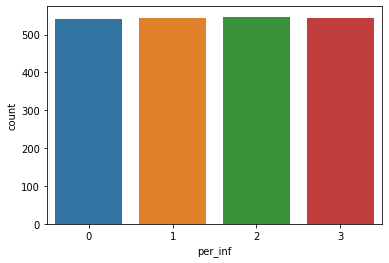

In [116]:
sns.countplot(demoinfdata['per_inf'])

In [117]:
# Separate the dataset - response and feature 
X= demoinfdata.drop('per_inf', axis=1)
y= demoinfdata['per_inf']

In [118]:
#Train and Test splitting of data 
X_train, X_test, y_train, y_test= train_test_split(X,y, test_size=0.3, random_state=42)

In [120]:
#Applying Standard scaling
sc= StandardScaler()
X_train= sc.fit_transform(X_train)
X_test= sc.transform(X_test)

In [121]:
#Using Random Forest Classifier 
rfc= RandomForestClassifier(n_estimators=1000, min_samples_leaf= 50, n_jobs= -1, random_state=42, oob_score= True, bootstrap= True)
rfc.fit(X_train, y_train)
pred_rfc= rfc.predict(X_test)

In [122]:
# Get numerical feature importances
var_list= list(demoinfdata.columns)
importances = list(rfc.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(val, round(importance, 2)) for val, importance in zip(var_list, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: Net_Mig              Importance: 0.1
Variable: BA_MALE              Importance: 0.09
Variable: BA_FEMALE            Importance: 0.09
Variable: Density_pop          Importance: 0.08
Variable: Active_physiscians   Importance: 0.06
Variable: Total_age18to64      Importance: 0.05
Variable: WA_MALE              Importance: 0.05
Variable: Female_age18to64     Importance: 0.04
Variable: Male_age65plus       Importance: 0.03
Variable: WA_FEMALE            Importance: 0.03
Variable: Male_age18to64       Importance: 0.02
Variable: Total_age65plus      Importance: 0.02
Variable: Male_age85plusr      Importance: 0.02
Variable: IA_MALE              Importance: 0.02
Variable: IA_FEMALE            Importance: 0.02
Variable: unemp_r              Importance: 0.02
Variable: Med_HH_INC           Importance: 0.02
Variable: PercentBSdeg         Importance: 0.02
Variable: Total_Male           Importance: 0.01
Variable: Total_Female         Importance: 0.01
Variable: Male_age0to17        Importance

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [123]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]
# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)
# Find number of features for cumulative importance of 95%
# Add 1 because Python is zero-indexed
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 35


In [127]:
# Extract the names of the most important features
important_feature_names = [feature[0] for feature in feature_importances[0:35]]
# Find the columns of the most important features
important_indices = [var_list.index(feature) for feature in important_feature_names]
# Create training and testing sets with only the important features
important_X_train = X_train[:, important_indices]
important_X_test = X_test[:, important_indices]
# Sanity check on operations
print('Important train features shape:', important_X_train.shape)
print('Important test features shape:', important_X_test.shape)

Important train features shape: (1525, 35)
Important test features shape: (654, 35)


In [130]:
#Tuning Hyperparameters
from sklearn.model_selection import RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)

{'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000], 'max_features': ['auto', 'sqrt'], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]}


In [131]:
# Use the random grid to search for best hyperparameters
# First create the base model to tune
rf = RandomForestClassifier()
# Random search of parameters, using 3 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -1)
# Fit the random search model
rf_random.fit(important_X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:  7.5min
[Parallel(n_jobs=-1)]: Done 300 out of 300 | elapsed: 13.5min finished


RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
               

In [132]:
#Display of best Hyperparameters
rf_random.best_params_

{'n_estimators': 600,
 'min_samples_split': 5,
 'min_samples_leaf': 1,
 'max_features': 'auto',
 'max_depth': 80,
 'bootstrap': True}

In [136]:
#Displaying Score of RFC
rfc= RandomForestClassifier(n_estimators= 600,min_samples_split= 5,min_samples_leaf= 1,max_features= 'auto',
                            max_depth= 80,bootstrap= True)
rfc.fit(important_X_train, y_train)
pred_rfc1= rfc.predict(important_X_test)
print(classification_report(y_test, pred_rfc1))
print(confusion_matrix(y_test, pred_rfc1))
score=rfc.score(important_X_test, y_test)
print('Accuracy of the model: ' + str(score))

              precision    recall  f1-score   support

           0       0.55      0.42      0.47       173
           1       0.53      0.65      0.58       172
           2       0.29      0.28      0.28       157
           3       0.31      0.33      0.32       152

    accuracy                           0.42       654
   macro avg       0.42      0.42      0.41       654
weighted avg       0.43      0.42      0.42       654

[[ 72  18  62  21]
 [  3 111  12  46]
 [ 40  30  44  43]
 [ 17  50  35  50]]
Accuracy of the model: 0.4235474006116208


In [78]:
#K Nearest Neighbour 
neigh = KNeighborsClassifier(algorithm= 'kd_tree')
neigh.fit(X_train, y_train)
neigh.score(X_test, y_test)

0.41131498470948014

In [79]:
#Tuning Hyperparameters for KNN
from sklearn.model_selection import GridSearchCV
#List Hyperparameters to tune
leaf_size = list(range(1,50))
n_neighbors = list(range(1,30))
p=[1,2]
#convert to dictionary
hyperparameters = dict(leaf_size=leaf_size, n_neighbors=n_neighbors, p=p)
#Making model
clf = GridSearchCV(neigh, hyperparameters, cv=10)
best_model = clf.fit(X_train,y_train)
#Best Hyperparameters Value
print('Best leaf_size:', best_model.best_estimator_.get_params()['leaf_size'])
print('Best p:', best_model.best_estimator_.get_params()['p'])
print('Best n_neighbors:', best_model.best_estimator_.get_params()['n_neighbors'])
#Predict testing set
y_pred = best_model.predict(X_test)

Best leaf_size: 1
Best p: 2
Best n_neighbors: 25


In [138]:
#Displaying score for KNN
from sklearn.metrics import accuracy_score
#Check performance using accuracy
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))
score=accuracy_score(y_test, y_pred)
print('Accuracy of the model: ' + str(score))

              precision    recall  f1-score   support

           0       0.60      0.51      0.55       173
           1       0.49      0.54      0.52       172
           2       0.32      0.31      0.31       157
           3       0.34      0.38      0.36       152

    accuracy                           0.44       654
   macro avg       0.44      0.43      0.43       654
weighted avg       0.44      0.44      0.44       654

[[88 11 53 21]
 [11 93 21 47]
 [28 38 48 43]
 [20 47 28 57]]
Accuracy of the model: 0.43730886850152906
